In [1]:
library(ranger)   # for Random Forest models
library(xgboost)  # for XGBoost models
library(tidyverse)
library(broom)
library(tidymodels)
library(vip)
library(DALEXtra)
options(scipen = 999)



── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
✖ dplyr::slice()  masks xgboost::slice()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ dials        1.2.1      ✔ rsample      1.2.0 
✔ infer        1.0.6      ✔ tune         1.1.2 
✔ modeldata    1.3.0      ✔ workflows    1.1.4 
✔ parsnip      1.2.0      ✔ workflowsets 1.0.1 
✔ recipes      1.0.10     ✔ yardstick    1.3.0 

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr

In [3]:
load('../DataSets/ml_datasets.RData')
rm(states)

glimpse(heart)
heart <- heart %>%
  rename(AHD = ahd)
# check missing values 
any(is.na(heart))
# there are!!!

Rows: 303
Columns: 14
$ age        <dbl> 63, 67, 67, 37, 41, 56, 62, 57, 63, 53, 57, 56, 56, 44, 52,…
$ sex        <fct> Male, Male, Male, Male, Female, Male, Female, Female, Male,…
$ chest_pain <fct> typical, asymptomatic, asymptomatic, nonanginal, nontypical…
$ rest_bp    <dbl> 145, 160, 120, 130, 130, 120, 140, 120, 130, 140, 140, 140,…
$ chol       <dbl> 233, 286, 229, 250, 204, 236, 268, 354, 254, 203, 192, 294,…
$ fbs        <fct> Yes, No, No, No, No, No, No, No, No, Yes, No, No, Yes, No, …
$ rest_ecg   <dbl> 2, 2, 2, 0, 2, 0, 2, 0, 2, 2, 0, 2, 2, 0, 0, 0, 0, 0, 0, 0,…
$ max_hr     <dbl> 150, 108, 129, 187, 172, 178, 160, 163, 147, 155, 148, 153,…
$ ex_ang     <fct> No, Yes, Yes, No, No, No, No, Yes, No, Yes, No, No, Yes, No…
$ oldpeak    <dbl> 2.3, 1.5, 2.6, 3.5, 1.4, 0.8, 3.6, 0.6, 1.4, 3.1, 0.4, 1.3,…
$ slope      <fct> 3, 2, 2, 3, 1, 1, 3, 1, 2, 3, 2, 2, 2, 1, 1, 1, 3, 1, 1, 1,…
$ ca         <dbl> 0, 3, 2, 0, 0, 0, 2, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0,…
$ thal       <fct>

[1] TRUE

### Main Split of the data

In [4]:
set.seed(1234)
splits   <- initial_split(heart, prop = 0.75, strata = AHD)
train_tbl <- training(splits)
test_tbl  <- testing(splits)


## cross-validation folds
set.seed(1234)
cv_train <- vfold_cv(train_tbl, v = 5, repeats = 1, strata = AHD)
cv_train

splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

### Data Recipe

In [8]:
the_recipe <- recipe(AHD ~ ., data = train_tbl) %>%
    step_impute_knn(all_predictors(), neighbors = 3) %>%   # missing values imputation
    step_dummy(all_nominal(), -all_outcomes()) %>% # dummification of the predictors
    step_zv(all_predictors()) # this removes predictors with zero variance


### Models Specifications

In [9]:

## RF
rf_spec <- parsnip::rand_forest(
     mtry = tune(), 
     trees = 500,
     min_n = tune()     
          ) %>%
     set_engine("ranger", importance = "impurity") %>%
     set_mode("classification")
rf_spec


### XGBoost
xgb_spec <- parsnip::boost_tree(
    trees = 700, 
    tree_depth = tune(), min_n = tune(), 
    loss_reduction = tune(),                     ## model complexity
    sample_size = tune(), mtry = tune(),         ## randomness
    learn_rate = tune()                         ## step size
    ) %>% 
    set_engine("xgboost") %>% 
    set_mode("classification")
xgb_spec


Random Forest Model Specification (classification)

Main Arguments:
  mtry = tune()
  trees = 500
  min_n = tune()

Engine-Specific Arguments:
  importance = impurity

Computational engine: ranger 


Boosted Tree Model Specification (classification)

Main Arguments:
  mtry = tune()
  trees = 700
  min_n = tune()
  tree_depth = tune()
  learn_rate = tune()
  loss_reduction = tune()
  sample_size = tune()

Computational engine: xgboost 


### Parameter grids Specifications

In [10]:
## for Random Forest models
set.seed(1234)
rf_grid <- dials::grid_random(
    finalize(mtry(), train_tbl %>% select (-AHD)),
    min_n(),  
    size = 20)  # the number should be larger, but nodel fitting would take longer

rf_grid


mtry,min_n
<int>,<int>
12,21
10,4
6,37
5,32
12,30
9,6
5,3
6,21
4,4


In [11]:
##  for XGBoost models
set.seed(1234)
xgb_grid <- dials::grid_random(
    tree_depth(),
    min_n(),
    loss_reduction(),
    sample_size = sample_prop(),
    finalize(mtry(), train_tbl %>% select (-AHD)),
    learn_rate(),
    size = 60   # the number should be larger, but it would take longer
)
xgb_grid

tree_depth,min_n,loss_reduction,sample_size,mtry,learn_rate
<int>,<int>,<dbl>,<dbl>,<int>,<dbl>
12,30,0.0000000009491273,0.2201947,3,0.0312764472119071
10,33,0.0021327010658330,0.5495917,1,0.0000216837849384
6,9,0.0000090508269186,0.8219221,3,0.0003816460110440
5,27,0.0000000006858594,0.4034379,13,0.0000024021912477
12,18,0.1688975001305681,0.5580286,1,0.0008191585406596
15,9,0.0000005504279625,0.5449947,9,0.0000000001067356
9,33,0.0511474401289893,0.8173476,12,0.0000105068294835
5,23,0.0005237480867708,0.6102630,12,0.0000013877064375
6,36,0.0141792473077607,0.1960271,13,0.0000000927761413


### Assembling the models with workflows

In [12]:
# Random forest
wf_rf <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) 


# XGBoost
wf_xgb <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(xgb_spec) 

### Fit the models for all cross-validation folds 

In [13]:
set.seed(1234)
rf_resamples <- wf_rf %>% 
    tune_grid(
        resamples = cv_train,
        grid = rf_grid,
        control = control_grid(save_pred = TRUE)
              )
rf_resamples
# temp <- rf_resamples$.notes[[1]][1]
# temp$.notes[1]


# XGBoost model, `original` data set
set.seed(1234)
xgb_resamples <- wf_xgb %>% 
    tune_grid(
        resamples = cv_train,
        grid = xgb_grid,
        control = control_grid(save_pred = TRUE)
              )
xgb_resamples

splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

### Model evaluation

mtry,min_n,.metric,.estimator,mean,n,std_err,.config
<int>,<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
12,21,accuracy,binary,0.7663241,5,0.01221427,Preprocessor1_Model01
12,21,roc_auc,binary,0.8656865,5,0.01960235,Preprocessor1_Model01
10,4,accuracy,binary,0.7880588,5,0.02414474,Preprocessor1_Model02
10,4,roc_auc,binary,0.8723016,5,0.01993211,Preprocessor1_Model02
6,37,accuracy,binary,0.7838120,5,0.01738078,Preprocessor1_Model03
6,37,roc_auc,binary,0.8669365,5,0.02025856,Preprocessor1_Model03
5,32,accuracy,binary,0.7840053,5,0.02498100,Preprocessor1_Model04
5,32,roc_auc,binary,0.8774603,5,0.02265191,Preprocessor1_Model04
12,30,accuracy,binary,0.7619763,5,0.01341453,Preprocessor1_Model05


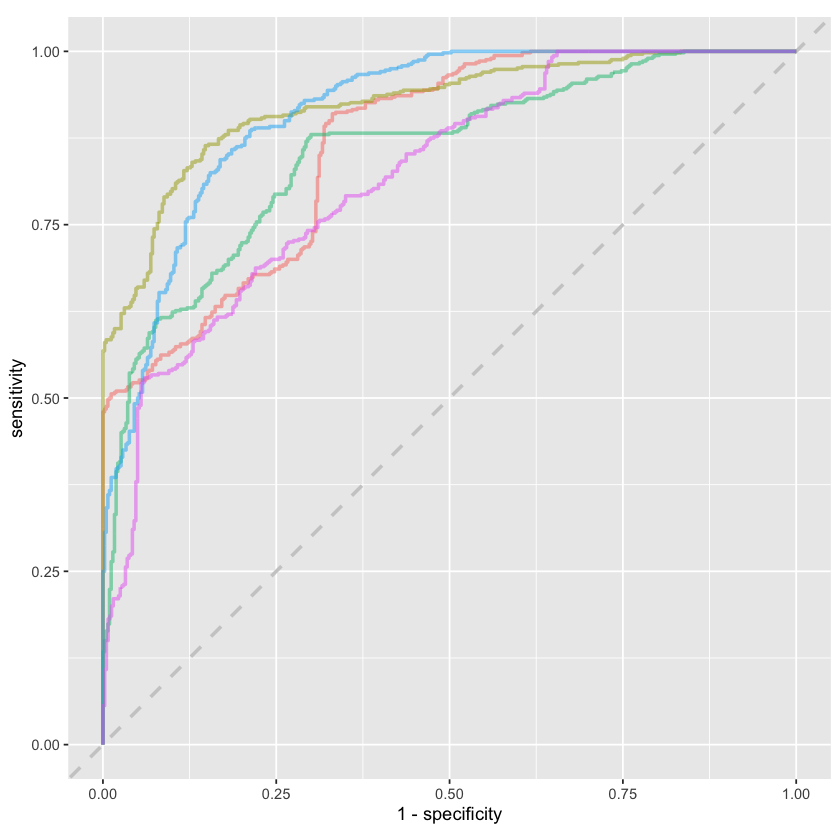

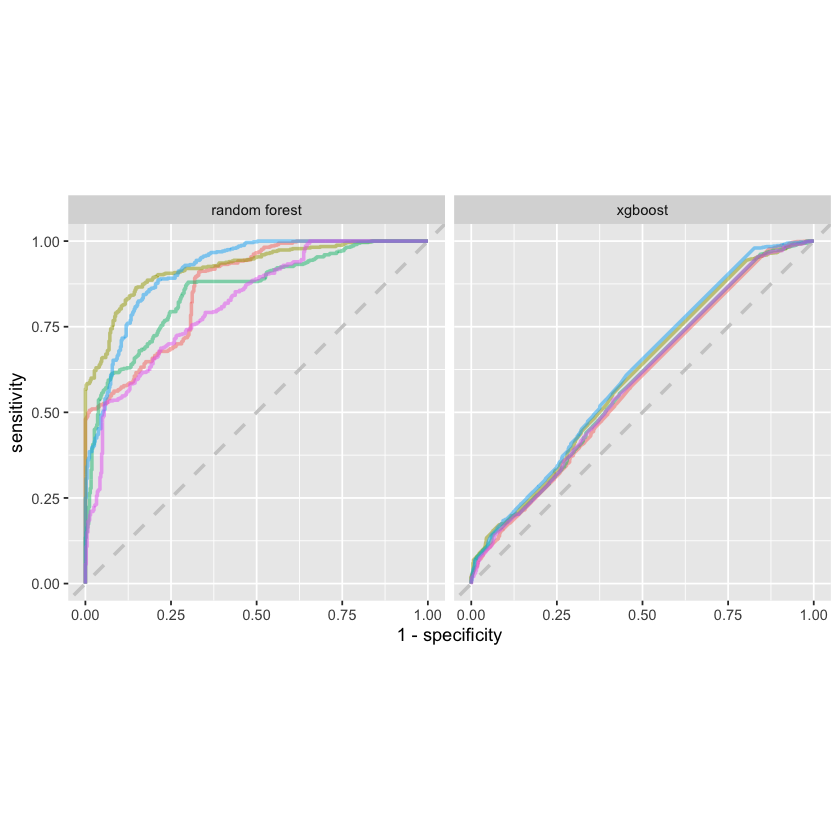

In [14]:
rf_resamples %>% 
    collect_metrics()

# roc curves
rf_resamples %>%
  collect_predictions() %>%
  group_by(id) %>%
  roc_curve(AHD, .pred_No) %>%
  ggplot(aes(1 - specificity, sensitivity, color = id)) +
  geom_abline(lty = 2, color = "gray80", linewidth = 1) +
  geom_path(show.legend = FALSE, alpha = 0.5, linewidth = 1) +
  coord_equal()


df_auc <- bind_rows(
    rf_resamples %>%
        collect_predictions() %>%
        group_by(id) %>%
        roc_curve(AHD, .pred_No)  %>%
        mutate (model = 'random forest'),
    xgb_resamples %>%
        collect_predictions() %>%
        group_by(id) %>%
        roc_curve(AHD, .pred_No)  %>%
        mutate (model = 'xgboost')
  ) %>%
  ggplot(aes(1 - specificity, sensitivity, color = id)) +
  geom_abline(lty = 2, color = "gray80", linewidth = 1) +
  geom_path(show.legend = FALSE, alpha = 0.5, linewidth = 1) +
  coord_equal() +
  facet_wrap(~ model)

df_auc


### Choose the best combination of hyper-parameter values

In [15]:
best_rf <- rf_resamples %>%
    select_best("roc_auc")

best_xgb <- xgb_resamples %>%
    select_best("roc_auc")

### Finalize the models

In [16]:
rf_model_wflow_fit <- finalize_workflow(wf_rf, best_rf)

xgb_model_wflow_fit <- finalize_workflow(wf_xgb, best_xgb)

### Variable importance

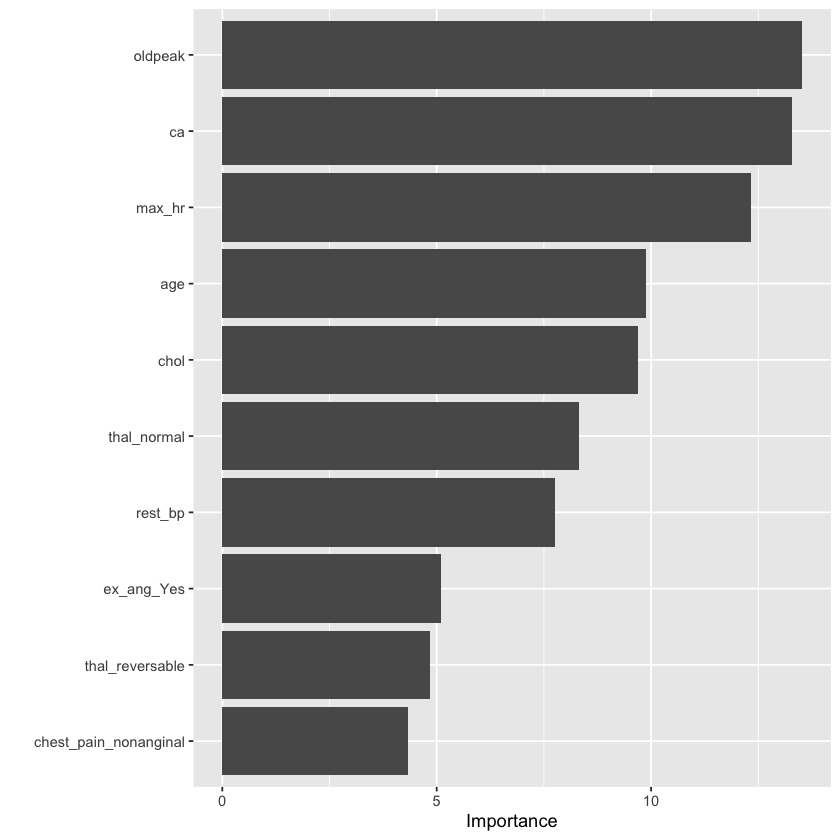

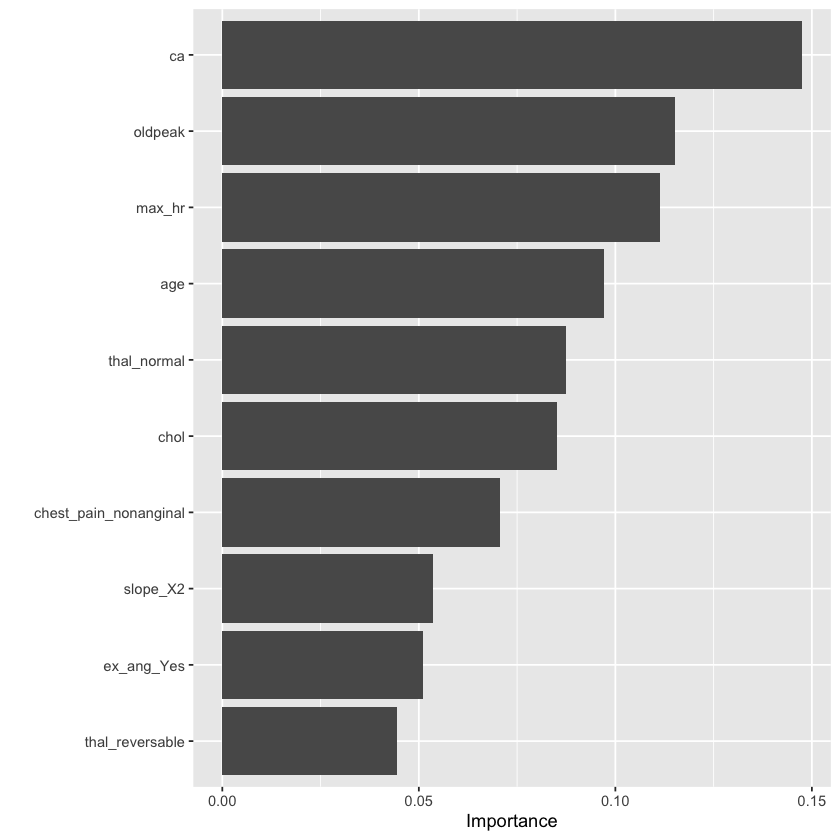

In [17]:

rf_model_wflow_fit %>% 
    fit(data = train_tbl) %>%
    extract_fit_parsnip() %>% 
    vip::vip() 


xgb_model_wflow_fit %>% 
    fit(data = train_tbl) %>%
    extract_fit_parsnip() %>% 
    vip::vip()

### Model performance on the test set

In [18]:
test__rf <- rf_model_wflow_fit %>% last_fit(splits) 
test__rf %>% collect_metrics() 

test__xgb <- xgb_model_wflow_fit %>% last_fit(splits) 
test__xgb %>% collect_metrics() 



.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
accuracy,binary,0.8421053,Preprocessor1_Model1
roc_auc,binary,0.9400697,Preprocessor1_Model1


.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
accuracy,binary,0.8421053,Preprocessor1_Model1
roc_auc,binary,0.9163763,Preprocessor1_Model1
